# Libraries

In [1]:
import numpy as np
import librosa
import librosa.display
from IPython.display import Audio
from IPython.display import Image
import matplotlib.pyplot as plt
import scipy.io.wavfile

---
# Channel reference photo

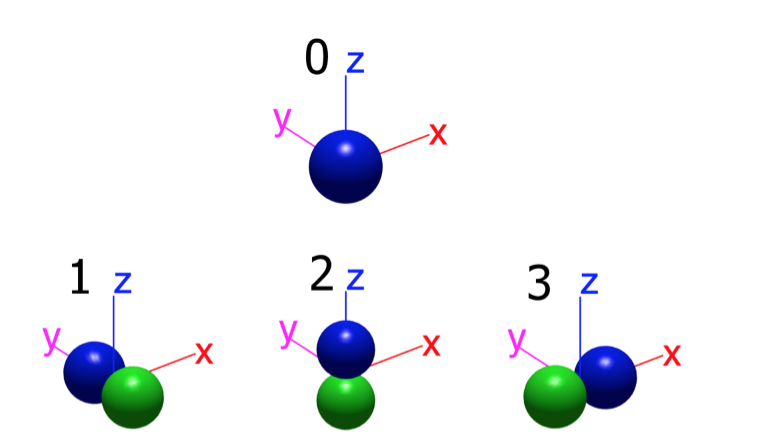

In [2]:
# Below channel ordering convention from Universita di Parma http://pcfarina.eng.unipr.it/Aurora/Ambisonics-Denoising.htm
display(Image(filename='SH.png'))

---
# Speaker Array Decoders

In [3]:
def b_format_to_speaker_square(x):
    
    W=x[0,:]
    Y=x[1,:]
    X=x[3,:]
    
    W*=1/np.sqrt(2)
    X*=1/np.sqrt(2)
    Y*=1/np.sqrt(2)
    
    #R = Right
    #L = Left
    #F = Front
    #B = Back
        
    RF= W+X-Y
    LF= W+X+Y
    LB= W-X+Y
    RB= W-X-Y

    
    out = np.array([RF, LF, LB, RB])
    return out

In [4]:
def b_format_to_speaker_cube(x):
    
    W=x[0,:]
    Y=x[1,:]
    Z=x[2,:]
    X=x[3,:]
    
    W*=1/np.sqrt(2)
    X*=.5
    Y*=.5
    Z*=1/np.sqrt(2)
    
    #R = Right
    #L = Left
    #F = Front
    #B = Back
    #U = Up
    #D = Down
    
    # incompletely described in page 284 in Immersive Sound 
    
    RFU= W+X-Y+Z
    LFU= W+X+Y+Z
    LBU= W-X+Y+Z
    RBU= W-X-Y+Z
    RFD= W+X-Y-Z
    LFD= W+X+Y-Z
    LBD= W-X+Y-Z
    RBD= W-X-Y-Z
    
    out = np.array([RFU, LFU, LBU, RBU, RFD, LFD, LBD, RBD])
    return out

In [5]:
def b_format_to_speaker_octagon(x):
    
    W=x[0,:]
    Y=x[1,:]
    X=x[3,:]
    
    #I added 2 in denominator below
    
    W*=1/2*np.sqrt(2)
    X*=1/2*np.sqrt(2)
    Y*=1/2*np.sqrt(2)
    
    #R = Right
    #L = Left
    #F = Front
    #B = Back
    
    # incompletely described in page 283 in Immersive Sound 
    
    RF= W+X-Y
    LF= W+X+Y
    LB= W-X+Y
    RB= W-X-Y
    F = W+X
    B = W-X
    L = W+Y
    R = W-Y
    
    out = np.array([RF, LF, LB, RB, F, B, L, R])
    return out

In [6]:
def b_format_to_speaker_octahedron(x):
    
    W=x[0,:]
    Y=x[1,:]
    Z=x[2,:]
    X=x[3,:]
    
    W*=1/np.sqrt(2)
    X*=1/np.sqrt(2)
    Y*=1/np.sqrt(2)
    Z*=1/np.sqrt(2)
    
    #R = Right
    #L = Left
    #F = Front
    #B = Back
    #U = Up
    #D = Down
    
    # incompletely described in page 283 in Immersive Sound 
    
    RF= W+X-Y
    LF= W+X+Y
    LB= W-X+Y
    RB= W-X-Y
    U= W+Z
    D= W-Z

    
    out = np.array([RF, LF, LB, RB, U, D])
    return out

---
# Speaker Array Binauralizers

In [7]:
def binaurauralize_speaker_square(x):
    HRIRS = np.array([
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_45,0_ele_0,0.wav', sr=44100, mono=False)[0],# 45 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_315,0_ele_0,0.wav', sr=44100, mono=False)[0],# 315 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_225,0_ele_0,0.wav', sr=44100, mono=False)[0],# 225 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_135,0_ele_0,0.wav', sr=44100, mono=False)[0]# 135 azimuth 0 elev
    ])
    
#     print("HRIRS shape: " , HRIRS.shape)
#     print("cube shape: " , x.shape)
    
    binaural_signal=np.zeros(shape=(2,len(x[0])))#[channel,sample]
    
    for n in range(4):
        binaural_signal[0]+= np.convolve(x[n,:],HRIRS[n,1,:], mode='same')
        binaural_signal[1]+= np.convolve(x[n,:],HRIRS[n,0,:], mode='same')
        
    return binaural_signal

In [8]:
def binaurauralize_speaker_cube(x):
    HRIRS = np.array([
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_45,0_ele_45,0.wav', sr=44100, mono=False)[0],# 45 azimuth 45 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_315,0_ele_45,0.wav', sr=44100, mono=False)[0],# 315 azimuth 45 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_225,0_ele_45,0.wav', sr=44100, mono=False)[0],# 225 azimuth 45 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_135,0_ele_45,0.wav', sr=44100, mono=False)[0],# 135 azimuth 45 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_45,0_ele_-45,0.wav', sr=44100, mono=False)[0],# 45 azimuth -45 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_315,0_ele_-45,0.wav', sr=44100, mono=False)[0],# 315 azimuth -45 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_225,0_ele_-45,0.wav', sr=44100, mono=False)[0],# 225 azimuth -45 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_135,0_ele_-45,0.wav', sr=44100, mono=False)[0]# 135 azimuth -45 elev
    ])
    
#     print("HRIRS shape: " , HRIRS.shape)
#     print("cube shape: " , x.shape)
    
    binaural_signal=np.zeros(shape=(2,len(x[0])))#[channel,sample]
    
    for n in range(8):
        binaural_signal[0]+= np.convolve(x[n,:],HRIRS[n,1,:], mode='same')
        binaural_signal[1]+= np.convolve(x[n,:],HRIRS[n,0,:], mode='same')
        
    return binaural_signal

In [9]:
def binaurauralize_speaker_octagon(x):
    HRIRS = np.array([
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_45,0_ele_0,0.wav', sr=44100, mono=False)[0],# 45 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_315,0_ele_0,0.wav', sr=44100, mono=False)[0],# 315 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_225,0_ele_0,0.wav', sr=44100, mono=False)[0],# 225 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_135,0_ele_0,0.wav', sr=44100, mono=False)[0],# 135 azimuth 0 elev
    #F B L R
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_0,0_ele_0,0.wav', sr=44100, mono=False)[0],# 0 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_180,0_ele_0,0.wav', sr=44100, mono=False)[0],# 180 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_270,0_ele_0,0.wav', sr=44100, mono=False)[0],# 270 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_90,0_ele_0,0.wav', sr=44100, mono=False)[0]# 90 azimuth 0 elev
    ])
    
    binaural_signal=np.zeros(shape=(2,len(x[0])))#[channel,sample]
    
    for n in range(8):
        binaural_signal[0]+= np.convolve(x[n,:],HRIRS[n,1,:], mode='same')
        binaural_signal[1]+= np.convolve(x[n,:],HRIRS[n,0,:], mode='same')
        
    return binaural_signal

In [10]:
def binaurauralize_speaker_octahedron(x):
    HRIRS = np.array([
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_45,0_ele_0,0.wav', sr=44100, mono=False)[0],# 45 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_315,0_ele_0,0.wav', sr=44100, mono=False)[0],# 315 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_225,0_ele_0,0.wav', sr=44100, mono=False)[0],# 225 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_135,0_ele_0,0.wav', sr=44100, mono=False)[0],# 135 azimuth 0 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_0,0_ele_90,0.wav', sr=44100, mono=False)[0],# 0 azimuth 90 elev
    librosa.load('D1_HRIR_WAV/44K_16bit/azi_0,0_ele_-90,0.wav', sr=44100, mono=False)[0] # 0 azimuth -90 elev
    ])
    
#     print("HRIRS shape: " , HRIRS.shape)
#     print("cube shape: " , x.shape)
    
    binaural_signal=np.zeros(shape=(2,len(x[0])))#[channel,sample]
    
    for n in range(4):
        binaural_signal[0]+= np.convolve(x[n,:],HRIRS[n,1,:], mode='same')
        binaural_signal[1]+= np.convolve(x[n,:],HRIRS[n,0,:], mode='same')
        
    return binaural_signal

---
# Testing

In [11]:
#Audio file from: https://pure.hud.ac.uk/ws/portalfiles/portal/18503381/AES_147EB_3D_mic_array_AAM.pdf

x, fs = librosa.load('30deg_063_Ambeo_B-Format.wav', sr=44100, mono=False)
#print(x.shape) #(4, 1584001)

#Square

speaker_square = b_format_to_speaker_square(x)
binaural_square = binaurauralize_speaker_square(speaker_square)
binaural_square /= np.max(binaural_square)*np.sign(np.max(binaural_square)) #Normalization
print("Virtual speaker square binauralized:")
display(Audio(binaural_square, rate = 44100))

#Cube

speaker_cube = b_format_to_speaker_cube(x)
binaural_cube = binaurauralize_speaker_cube(speaker_cube)
binaural_cube /= np.max(binaural_cube)*np.sign(np.max(binaural_cube)) #Normalization
print("Virtual speaker cube binauralized:")
display(Audio(binaural_cube, rate = 44100))

#Octagon

speaker_octagon = b_format_to_speaker_octagon(x)
binaural_octagon = binaurauralize_speaker_octagon(speaker_octagon)
binaural_octagon /= np.max(binaural_octagon)*np.sign(np.max(binaural_octagon)) #Normalization
print("Virtual speaker octagon binauralized:")
display(Audio(binaural_octagon, rate = 44100))

#Octahedron

speaker_octahedron = b_format_to_speaker_octahedron(x)
binaural_octahedron = binaurauralize_speaker_octahedron(speaker_octahedron)
binaural_octahedron /= np.max(binaural_octahedron)*np.sign(np.max(binaural_octahedron)) #Normalization
print("Virtual speaker octahedron binauralized:")
display(Audio(binaural_octahedron, rate = 44100))

#VST

print("iem Binaural Decoder:")
x2, fs2 = librosa.load('30deg_063_Ambeo_Binaural_VST.wav', sr=44100, mono=False)
display(Audio(x2, rate = fs2))

Virtual speaker square binauralized:


Virtual speaker cube binauralized:


Virtual speaker octagon binauralized:


Virtual speaker octahedron binauralized:


iem Binaural Decoder:


# Spectrograms

These are spectrograms of the left and right channels of each binaural signal respectively. The intensity is decibel scale and the frequency is mel scale, so that percievable visual differences should correspond with percievable auditory differences.

Square  interchannel correlation:  [20885.13164876]
Cube  interchannel correlation:  [24375.23171866]
Octagon  interchannel correlation:  [22938.05209217]
Octahedron  interchannel correlation:  [22466.22088916]
VST interchannel correlation:  [2128.9587]


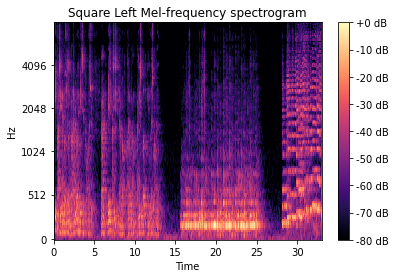

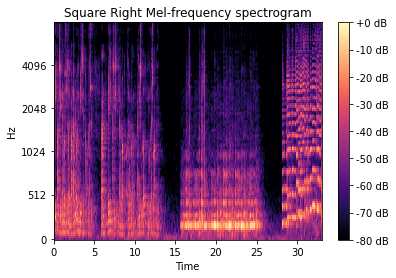

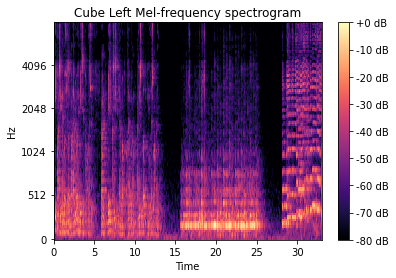

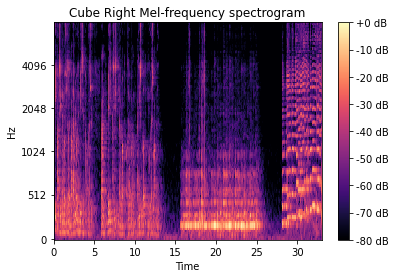

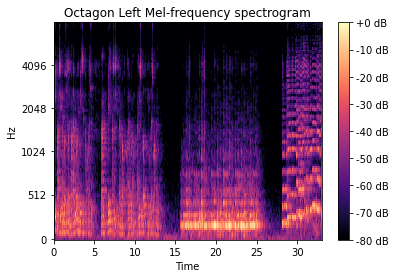

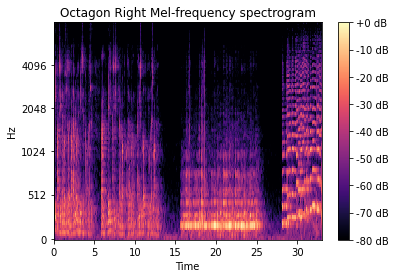

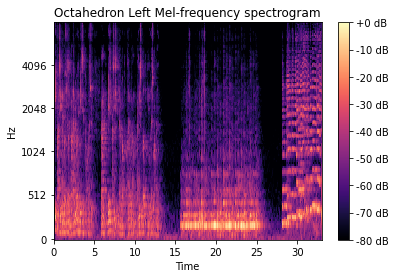

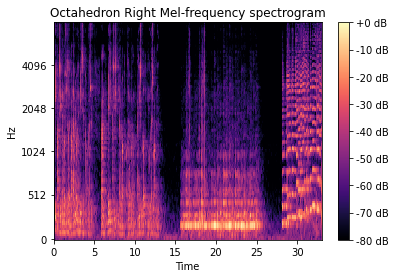

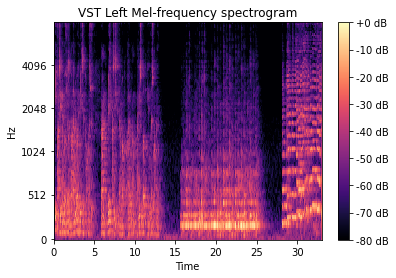

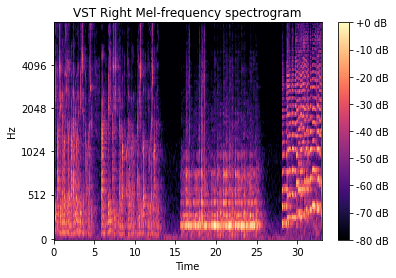

In [12]:
sigs = np.array([binaural_square, binaural_cube, binaural_octagon, binaural_octahedron])
names = ["Square","Cube", "Octagon", "Octahedron" ]

#Spectrogram code from example in: https://librosa.org/doc/latest/generated/librosa.feature.melspectrogram.html

for i in range(4):
    
    #scipy.io.wavfile.write(names[i] + "binauralized.wav", fs, sigs[i].T)
    
    for j in range(2):
        S1 = librosa.feature.melspectrogram(y=sigs[i,j], sr=fs, n_mels=128, fmax=8000)
        fig, ax = plt.subplots()
        S_dB = librosa.power_to_db(S1, ref=np.max)
        img = librosa.display.specshow(S_dB, x_axis='time',y_axis='mel', sr=fs,fmax=8000, ax=ax)
        fig.colorbar(img, ax=ax, format='%+2.0f dB')
        if(j ==0):
            ax.set(title=names[i]+' Left Mel-frequency spectrogram')
        else: 
            ax.set(title=names[i]+' Right Mel-frequency spectrogram')
            
    print(names[i], " interchannel correlation: ", np.correlate(sigs[i,0], sigs[i,1]))

print("VST interchannel correlation: ", np.correlate(x2[0], x2[1]))
    
for j in range(2):
    S1 = librosa.feature.melspectrogram(y=x2[j], sr=fs, n_mels=128, fmax=8000)
    fig, ax = plt.subplots()
    S_dB = librosa.power_to_db(S1, ref=np.max)
    img = librosa.display.specshow(S_dB, x_axis='time',y_axis='mel', sr=fs,fmax=8000, ax=ax)
    fig.colorbar(img, ax=ax, format='%+2.0f dB')
    if(j ==0):
        ax.set(title='VST Left Mel-frequency spectrogram')
    else: 
        ax.set(title='VST Right Mel-frequency spectrogram')